# DS Random Forest/Decision Trees

In [7]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn import tree
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import train_test_split
from sklearn.tree import DecisionTreeClassifier
from sklearn.metrics import classification_report, ConfusionMatrixDisplay, confusion_matrix, accuracy_score
from sklearn.tree import plot_tree
from sklearn.ensemble import RandomForestClassifier
from sklearn.model_selection import GridSearchCV

In [8]:
df = pd.read_csv('/home/gmelao/Desktop/default-of-credit-card-clients.csv')
df.columns = df.iloc[0]
df.drop(0, inplace = True)
df.set_index('ID', inplace = True)
pd.set_option('display.max_columns', 24)
pd.set_option('display.max_rows', 24)

In [9]:
df2 = df.apply(lambda df: pd.Series(map(float, df)))

In [15]:
df2.columns

Index(['LIMIT_BAL', 'SEX', 'EDUCATION', 'MARRIAGE', 'AGE', 'PAY_0', 'PAY_2',
       'PAY_3', 'PAY_4', 'PAY_5', 'PAY_6', 'BILL_AMT1', 'BILL_AMT2',
       'BILL_AMT3', 'BILL_AMT4', 'BILL_AMT5', 'BILL_AMT6', 'PAY_AMT1',
       'PAY_AMT2', 'PAY_AMT3', 'PAY_AMT4', 'PAY_AMT5', 'PAY_AMT6',
       'default payment next month'],
      dtype='object', name=0)

### Split Train Test - Decision Tree

In [4]:
X = df2
y = df2['LIMIT_BAL']
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.33, random_state=42)

In [5]:
model = DecisionTreeClassifier()
model.fit(X_train, y_train)

DecisionTreeClassifier()

In [6]:
pd.DataFrame(index=X.columns, data = model.feature_importances_, columns=['Feature Importance']).sort_values('Feature Importance')

,Feature Importance
0,
BILL_AMT1,0.000000
PAY_AMT4,0.000000
PAY_AMT3,0.000000
PAY_AMT2,0.000000
PAY_AMT1,0.000000
BILL_AMT5,0.000000
BILL_AMT2,0.000000
PAY_AMT6,0.000000
PAY_6,0.000000


In [7]:
def report_model(model): 
    preds = model.predict(X_test)
    print(classification_report(y_test, preds))
    print('\n')
    plt.figure(figsize=(40,40), dpi=600)
    plot_tree(model, feature_names = X.columns, filled=True);

In [8]:
report_model(model)

/home/gmelao/mambaforge/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/gmelao/mambaforge/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/gmelao/mambaforge/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/gmelao/mambaforge/lib/pytho

              precision    recall  f1-score   support

     10000.0       1.00      1.00      1.00       165
     20000.0       1.00      1.00      1.00       690
     30000.0       1.00      1.00      1.00       509
     40000.0       1.00      1.00      1.00        73
     50000.0       1.00      1.00      1.00      1110
     60000.0       1.00      1.00      1.00       264
     70000.0       1.00      1.00      1.00       254
     80000.0       1.00      1.00      1.00       510
     90000.0       1.00      1.00      1.00       207
    100000.0       1.00      1.00      1.00       358
    110000.0       1.00      1.00      1.00       197
    120000.0       1.00      1.00      1.00       225
    130000.0       1.00      1.00      1.00       238
    140000.0       1.00      1.00      1.00       229
    150000.0       1.00      1.00      1.00       363
    160000.0       1.00      1.00      1.00       204
    170000.0       1.00      1.00      1.00       177
    180000.0       1.00    

In [9]:
pruned_tree = DecisionTreeClassifier(max_depth = 2)
pruned_tree.fit(X_train, y_train)
report_model(pruned_tree)

/home/gmelao/mambaforge/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/gmelao/mambaforge/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/gmelao/mambaforge/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

     10000.0       0.00      0.00      0.00       165
     20000.0       0.48      1.00      0.65       690
     30000.0       0.00      0.00      0.00       509
     40000.0       0.00      0.00      0.00        73
     50000.0       1.00      1.00      1.00      1110
     60000.0       0.00      0.00      0.00       264
     70000.0       0.00      0.00      0.00       254
     80000.0       0.50      1.00      0.66       510
     90000.0       0.00      0.00      0.00       207
    100000.0       0.00      0.00      0.00       358
    110000.0       0.00      0.00      0.00       197
    120000.0       0.00      0.00      0.00       225
    130000.0       0.00      0.00      0.00       238
    140000.0       0.00      0.00      0.00       229
    150000.0       0.00      0.00      0.00       363
    160000.0       0.00      0.00      0.00       204
    170000.0       0.00      0.00      0.00       177
    180000.0       0.00    

### Random Forest

In [10]:
rfc = RandomForestClassifier(n_estimators=100)
rfc.fit(X_train, y_train)

RandomForestClassifier()

In [11]:
preds2 = rfc.predict(X_test)

In [12]:
pd.DataFrame(index=X.columns, data = rfc.feature_importances_, columns=['RFC Feature Importance']).sort_values('RFC Feature Importance')

,RFC Feature Importance
0,
default payment next month,0.007679
PAY_5,0.008482
PAY_4,0.009029
PAY_3,0.009752
PAY_2,0.009835
PAY_6,0.009851
SEX,0.011027
MARRIAGE,0.011470
PAY_0,0.013092


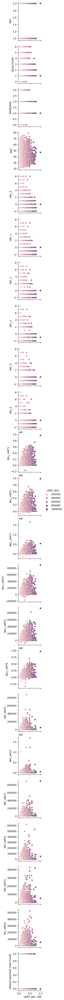

In [16]:
sns.pairplot(df2, hue='LIMIT_BAL', x_vars='LIMIT_BAL')

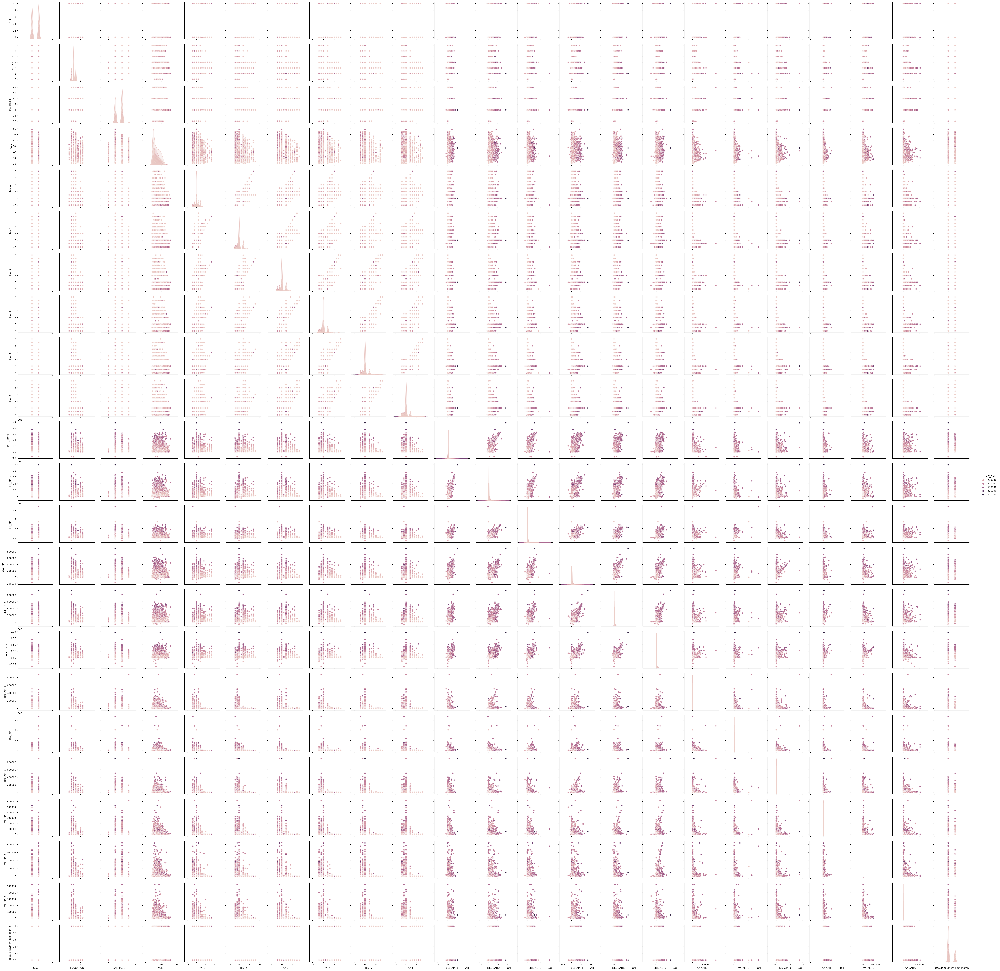

In [13]:
sns.pairplot(df2, hue='LIMIT_BAL')

### GridSearch

In [14]:
X = df2.drop('LIMIT_BAL', axis=1)
y = df2['LIMIT_BAL']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.15, random_state=42)

n_estimators = [200]
max_features = [4]
bootstrap = [True]
oob_score = [False]
param_grid = {'n_estimators':n_estimators,
             'max_features':max_features,
             'bootstrap':bootstrap,
             'oob_score':oob_score}

In [15]:
grid = GridSearchCV(rfc, param_grid)
grid.fit(X_train, y_train)

/home/gmelao/mambaforge/lib/python3.10/site-packages/sklearn/model_selection/_split.py:700: UserWarning: The least populated class in y has only 1 members, which is less than n_splits=5.
  warnings.warn(


GridSearchCV(estimator=RandomForestClassifier(),
             param_grid={'bootstrap': [True], 'max_features': [4],
                         'n_estimators': [200], 'oob_score': [False]})

In [16]:
#grid.best_params_

{'bootstrap': True, 'max_features': 4, 'n_estimators': 200, 'oob_score': False}

In [17]:
report_model(grid)

/home/gmelao/mambaforge/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/gmelao/mambaforge/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/gmelao/mambaforge/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1344: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


              precision    recall  f1-score   support

     10000.0       0.45      0.61      0.52        79
     20000.0       0.46      0.73      0.57       310
     30000.0       0.47      0.54      0.50       235
     40000.0       0.00      0.00      0.00        30
     50000.0       0.38      0.65      0.48       498
     60000.0       0.37      0.29      0.32       111
     70000.0       0.38      0.32      0.34       110
     80000.0       0.24      0.32      0.27       216
     90000.0       0.27      0.17      0.21        96
    100000.0       0.29      0.28      0.28       174
    110000.0       0.31      0.23      0.26        92
    120000.0       0.18      0.10      0.13       106
    130000.0       0.27      0.19      0.22       105
    140000.0       0.26      0.23      0.25       109
    150000.0       0.11      0.11      0.11       178
    160000.0       0.17      0.12      0.14       102
    170000.0       0.23      0.10      0.14        77
    180000.0       0.14    

AttributeError: 'GridSearchCV' object has no attribute 'tree_'

In [ ]:
errors = []
misclassifications = []

for n in range(1,200):
    rfc = RandomForestClassifier(n_estimators=n, max_features=4)
    rfc.fit(X_train, y_train)
    preds = rfc.predict(X_test)
    err = 1 - accuracy_score(y_test, preds)
    missed = np.sum(preds != y_test)
    
    errors.append(err)
    missclassifications.append(missed)

In [ ]:
plt.plot(range(1,200), errors)